<h2> split users </h2>
here the split sets of movielens dataset(ua.test,ua.base) is not used . beacause we are focousing on handling cold start . so we need to split ratings to two sets where one set contains users that we assume there is no information of their ratings

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
# Based on the file content, the data is tab-separated and contains rating information.
all_ratings = pd.read_csv('/content/drive/MyDrive/ml-100k/u.data', sep='\t', header=None, encoding='latin-1', names=['UID', 'MID', 'rating', 'timestamp'])
all_ratings.head()

,UID,MID,rating,timestamp
0,196,242,3,881250949
1,186,302,3,891717742
2,22,377,1,878887116
3,244,51,2,880606923
4,166,346,1,886397596


In [ ]:
all_users = pd.read_csv('/content/drive/MyDrive/ml-100k/u.user', sep='\\|', header=None, encoding='latin-1', names=['UID', 'age', 'gender', 'job', 'zip'])
all_users.head()

/tmp/ipython-input-151349353.py:1: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  all_users = pd.read_csv('/content/drive/MyDrive/ml-100k/u.user', sep='\\|', header=None, encoding='latin-1', names=['UID', 'age', 'gender', 'job', 'zip'])


,UID,age,gender,job,zip
0,1,24,M,technician,85711
1,2,53,F,other,94043
2,3,23,M,writer,32067
3,4,24,M,technician,43537
4,5,33,F,other,15213


In [ ]:
from sklearn.model_selection import train_test_split


# sample 20% unique users
#all_users = all_ratings['UID'].unique()
train_users,test_users = train_test_split(all_users, test_size=0.20, random_state=42)

# split logs
train_ratings = all_ratings[all_ratings['UID'].isin(train_users['UID']).tolist()]
test_ratings  = all_ratings[all_ratings['UID'].isin(test_users['UID']).tolist()]


<h2> create user combined features(demo infoes + graph infoes) </h2>
for both users :train and test users

In [ ]:
import numpy as np
import pandas as pd
import scipy
import matplotlib as plt
import networkx as nx
import itertools
import collections
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder


In [ ]:
def convert_categorical(df_X, _X):
    values = np.array(df_X[_X])
    # integer encode
    label_encoder = LabelEncoder()
    integer_encoded = label_encoder.fit_transform(values)
    # binary encode
    onehot_encoder = OneHotEncoder(sparse_output=False)
    integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
    onehot_encoded = onehot_encoder.fit_transform(integer_encoded)
    df_X = df_X.drop(_X, axis = 1)
    for j in range(integer_encoded.max() + 1):
        df_X.insert(loc=j + 1, column=str(_X) + str(j + 1), value=onehot_encoded[:, j])
    return df_X

In [ ]:





alpha_coefs = [0.005, 0.01, 0.015, 0.02, 0.025, 0.03, 0.035, 0.04, 0.045]


train_users = convert_categorical(train_users, 'job')
train_users = convert_categorical(train_users, 'gender')
train_users['bin'] = pd.cut(train_users['age'], [0, 10, 20, 30, 40, 50, 100], labels=['1', '2', '3', '4', '5', '6'])
train_users['age'] = train_users['bin']

train_users = train_users.drop('bin', axis = 1)
train_users = convert_categorical(train_users, 'age')
train_users = train_users.drop('zip', axis =1)

for alpha_coef in alpha_coefs:
    pairs = []
    grouped = train_ratings.groupby(['MID', 'rating'])
    for key, group in grouped:
        pairs.extend(list(itertools.combinations(group['UID'], 2)))
    counter = collections.Counter(pairs)
    print(counter)
    alpha = alpha_coef * 1682  # param*i_no
    edge_list = map(list, collections.Counter(el for el in counter.elements() if counter[el] >= alpha).keys())
    G = nx.Graph()

    for el in edge_list:
        G.add_edge(el[0], el[1], weight=1)
        G.add_edge(el[0], el[0], weight=1)
        G.add_edge(el[1], el[1], weight=1)

    pr = nx.pagerank(G.to_directed())
    train_users['PR'] = train_users['UID'].map(pr)
    train_users['PR'] /= float(train_users['PR'].max())
    dc = nx.degree_centrality(G)
    train_users['CD'] = train_users['UID'].map(dc)
    train_users['CD'] /= float(train_users['CD'].max())
    cc = nx.closeness_centrality(G)
    train_users['CC'] = train_users['UID'].map(cc)
    train_users['CC'] /= float(train_users['CC'].max())
    bc = nx.betweenness_centrality(G)
    train_users['CB'] = train_users['UID'].map(bc)
    train_users['CB'] /= float(train_users['CB'].max())
    lc = nx.load_centrality(G)
    train_users['LC'] = train_users['UID'].map(lc)
    train_users['LC'] /= float(train_users['LC'].max())
    nd = nx.average_neighbor_degree(G, weight='weight')
    train_users['AND'] = train_users['UID'].map(nd)
    train_users['AND'] /= float(train_users['AND'].max())
    X_train = train_users[train_users.columns[1:]]
    X_train.fillna(0, inplace=True)

    X_train.to_pickle("/content/drive/MyDrive/data100k_alpha_coldstart/x_train_alpha("+str(alpha_coef)+").pkl")

Counter({(293, 655): 97, (537, 655): 94, (201, 655): 94, (92, 916): 90, (234, 655): 90, (474, 846): 87, (416, 532): 84, (234, 537): 84, (7, 846): 81, (293, 916): 80, (94, 846): 80, (92, 896): 79, (429, 916): 78, (13, 846): 78, (59, 846): 78, (94, 880): 77, (457, 864): 76, (393, 880): 76, (92, 880): 75, (429, 682): 75, (85, 655): 75, (378, 916): 74, (655, 916): 74, (429, 864): 73, (85, 537): 73, (94, 429): 73, (293, 896): 72, (429, 655): 72, (561, 916): 72, (268, 916): 72, (92, 804): 72, (94, 916): 71, (92, 429): 71, (393, 749): 71, (378, 864): 71, (201, 537): 71, (92, 682): 70, (92, 889): 70, (429, 880): 70, (59, 592): 70, (429, 804): 70, (59, 474): 70, (313, 846): 70, (13, 880): 69, (293, 429): 69, (435, 916): 69, (378, 889): 69, (291, 880): 69, (92, 864): 69, (94, 864): 69, (59, 457): 69, (416, 796): 69, (59, 716): 69, (561, 655): 68, (94, 682): 68, (406, 916): 68, (497, 682): 68, (291, 864): 67, (293, 682): 67, (682, 916): 67, (393, 798): 67, (435, 880): 67, (429, 749): 67, (301, 80

/tmp/ipython-input-4083541485.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train.fillna(0, inplace=True)


Counter({(293, 655): 97, (537, 655): 94, (201, 655): 94, (92, 916): 90, (234, 655): 90, (474, 846): 87, (416, 532): 84, (234, 537): 84, (7, 846): 81, (293, 916): 80, (94, 846): 80, (92, 896): 79, (429, 916): 78, (13, 846): 78, (59, 846): 78, (94, 880): 77, (457, 864): 76, (393, 880): 76, (92, 880): 75, (429, 682): 75, (85, 655): 75, (378, 916): 74, (655, 916): 74, (429, 864): 73, (85, 537): 73, (94, 429): 73, (293, 896): 72, (429, 655): 72, (561, 916): 72, (268, 916): 72, (92, 804): 72, (94, 916): 71, (92, 429): 71, (393, 749): 71, (378, 864): 71, (201, 537): 71, (92, 682): 70, (92, 889): 70, (429, 880): 70, (59, 592): 70, (429, 804): 70, (59, 474): 70, (313, 846): 70, (13, 880): 69, (293, 429): 69, (435, 916): 69, (378, 889): 69, (291, 880): 69, (92, 864): 69, (94, 864): 69, (59, 457): 69, (416, 796): 69, (59, 716): 69, (561, 655): 68, (94, 682): 68, (406, 916): 68, (497, 682): 68, (291, 864): 67, (293, 682): 67, (682, 916): 67, (393, 798): 67, (435, 880): 67, (429, 749): 67, (301, 80

In [ ]:
import pickle
alpha=0.005

file_path = f"/content/drive/MyDrive/data100k_alpha_coldstart/x_train_alpha({alpha}).pkl"

with open(file_path, 'rb') as file:
    X_train = pickle.load(file)

X_train

,age1,age2,age3,age4,age5,age6,gender1,gender2,job1,job2,...,job18,job19,job20,job21,PR,CD,CC,CB,LC,AND
244,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
82,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.409550,0.486936,0.782649,0.039228,0.039986,0.795033
316,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.080029,0.007126,0.546580,0.000000,0.000000,0.360704
350,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.093348,0.007126,0.436979,0.000000,0.000000,0.025546
465,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.252731,0.289786,0.723900,0.004801,0.004973,0.870920
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
270,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.702501,0.852732,0.925028,0.158529,0.159291,0.659529
860,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.061342,0.019002,0.589185,0.000000,0.000000,0.733797
435,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.266512,0.318290,0.734676,0.000743,0.000753,0.915683


In [ ]:
X_train_df = X_train.copy()

<h2> use Autoencoder to decomposite the train features(side+graph features) </h2>

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)



In [ ]:
test_size=0.2
latent_dim=10
epochs=50
batch_size=32

In [ ]:
X_train_val, X_test_val = train_test_split(X_train, test_size=test_size, random_state=42)


In [ ]:
# Set all seeds for reproducibility
import random
import os
import tensorflow as tf

seed = 42
np.random.seed(seed)
random.seed(seed)
tf.random.set_seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 35)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │         4,608 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 10)             │           330 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 32)             │           352 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 64)             │         2,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 128)            │         8,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 35)             │         4,515 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 30,573 (119.43 KB)

 Trainable params: 30,573 (119.43 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 1.0031 - val_loss: 0.9414
Epoch 2/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.9425 - val_loss: 0.8630
Epoch 3/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.8441 - val_loss: 0.7775
Epoch 4/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.7465 - val_loss: 0.7090
Epoch 5/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.6676 - val_loss: 0.6591
Epoch 6/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.6073 - val_loss: 0.6182
Epoch 7/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.5612 - val_loss: 0.5802
Epoch 8/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.5190 - val_loss: 0.5490
Epoch 9/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.4804 - val_loss: 0.5142
Epoch 10/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.4414 - val_loss: 0.4849
Epoch 11/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.4043 - val_loss: 0.4579
Epoch 12/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.3733 - val_

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 35)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │         4,608 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 10)             │           330 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,274 (59.66 KB)

 Trainable params: 15,274 (59.66 KB)

 Non-trainable params: 0 (0.00 B)

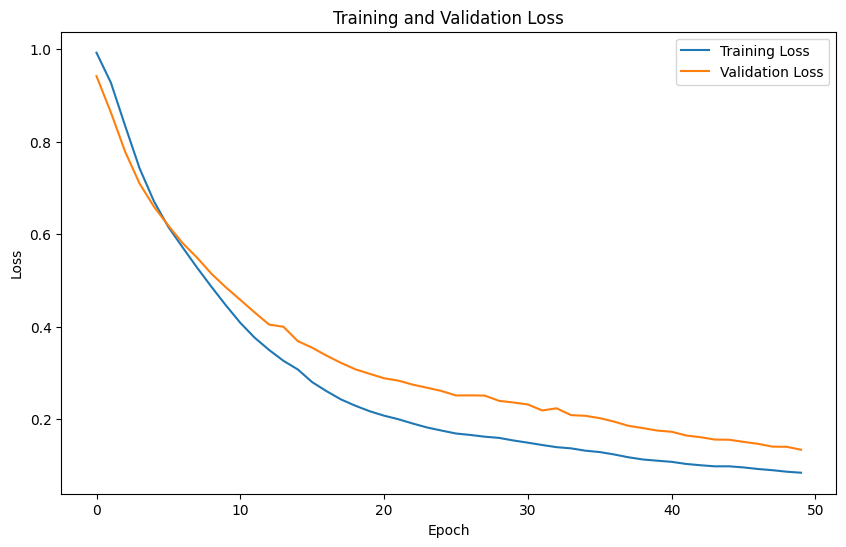

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.layers import Input, Dense, LeakyReLU
from tensorflow.keras.activations import relu, tanh
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping # Import EarlyStopping

input_dim = X_train.shape[1]

    # --- (Encoder) ---
input_layer = Input(shape=(input_dim,))
encoded4 = Dense(128, activation=relu)(input_layer)
encoded3 = Dense(64, activation=relu)(encoded4)
encoded2 = Dense(32, activation=relu)(encoded3)
#encoded1 = Dense(64, activation=LeakyReLU(0.3))(encoded2)
latent_representation = Dense(latent_dim, activation=tanh)(encoded2) # لایه گلوگاه

     #decoder
decoded1 = Dense(32, activation=relu)(latent_representation)
decoded2 = Dense(64, activation=relu)(decoded1)
decoded3 = Dense(128, activation=relu)(decoded2)
#decoded4 = Dense(512, activation=LeakyReLU(0.3))(decoded3)

output_layer = Dense(input_dim, activation='linear')(decoded3)

    # ---create  Autoencoder model ---
autoencoder = Model(input_layer, output_layer)
autoencoder.summary()


autoencoder.compile(loss='mse', optimizer='adam')

# Define EarlyStopping callback
# Monitor 'val_loss' (validation loss)
# 'patience' is the number of epochs with no improvement after which training will be stopped.
# 'restore_best_weights' restores model weights from the epoch with the best value of the monitored quantity.
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)


history = autoencoder.fit(
        X_train_val, X_train_val,
        epochs=epochs,
        batch_size=batch_size,
        shuffle=False,
        validation_data=(X_test_val, X_test_val), # ارزیابی عملکرد بر روی داده‌های آزمایشی
        callbacks=[early_stopping] # Add the callback here
)

    # 6. ساخت مدل Encoder برای استخراج ویژگی‌ها
encoder_model = Model(input_layer, latent_representation) # این مدل فقط بخش Encoder را شامل می‌شود
encoder_model.summary()
    # 7. (اختیاری) نمایش نمودار Loss
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
X_train_encoded = encoder_model.predict(X_train)

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


<h2> create the graph features for test_users based on the graph features of N nearest train users features </h2>

In [ ]:
X_train_df

,age1,age2,age3,age4,age5,age6,gender1,gender2,job1,job2,...,job18,job19,job20,job21,PR,CD,CC,CB,LC,AND
244,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
82,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.409550,0.486936,0.782649,0.039228,0.039986,0.795033
316,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.080029,0.007126,0.546580,0.000000,0.000000,0.360704
350,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.093348,0.007126,0.436979,0.000000,0.000000,0.025546
465,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.252731,0.289786,0.723900,0.004801,0.004973,0.870920
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
270,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.702501,0.852732,0.925028,0.158529,0.159291,0.659529
860,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.061342,0.019002,0.589185,0.000000,0.000000,0.733797
435,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.266512,0.318290,0.734676,0.000743,0.000753,0.915683


In [ ]:
test_users.columns

Index(['UID', 'age', 'gender', 'job', 'zip'], dtype='object')

In [ ]:
from sklearn.neighbors import NearestNeighbors

def impute_graph_features(test_users, train_users, graph_cols, k=5):
    # Use only side-info for similarity
    side_cols = [col for col in X_train_df.columns if col not in graph_cols + ['UID']]
    X_train = X_train_df[side_cols].values
    X_test = test_users.values

    # Fit KNN
    knn = NearestNeighbors(n_neighbors=k, metric='cosine')
    knn.fit(X_train)
    distances, indices = knn.kneighbors(X_test)

    # Impute graph features
    for col in graph_cols:
        test_users[col] = [train_users.iloc[neighbors][col].mean() for neighbors in indices]

    return test_users


In [ ]:
graph_cols = ['PR', 'CD', 'CC', 'CB', 'LC', 'AND']
test_users = convert_categorical(test_users, 'job')
test_users = convert_categorical(test_users, 'gender')
test_users['bin'] = pd.cut(test_users['age'], [0, 10, 20, 30, 40, 50, 100], labels=['1','2','3','4','5','6'])
test_users['age'] = test_users['bin']
test_users = test_users.drop(['bin', 'zip'], axis=1)
test_users = convert_categorical(test_users, 'age')



In [ ]:
# Add 'age6' column with zeros if it doesn't exist
if 'age6' not in test_users.columns:
  test_users.insert(loc=6, column='age6', value=0)



In [ ]:
test_users

,UID,age1,age2,age3,age4,age5,age6,gender1,gender2,job1,...,job12,job13,job14,job15,job16,job17,job18,job19,job20,job21
96,97,0.0,0.0,0.0,1.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
265,266,0.0,0.0,0.0,0.0,1.0,0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
810,811,0.0,0.0,1.0,0.0,0.0,0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23,24,0.0,1.0,0.0,0.0,0.0,0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30,31,0.0,1.0,0.0,0.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
832,833,0.0,0.0,1.0,0.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
551,552,0.0,0.0,0.0,1.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
109,110,1.0,0.0,0.0,0.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
77,78,0.0,1.0,0.0,0.0,0.0,0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
test_users_ = test_users.drop(columns=['UID'])
test_users_ = impute_graph_features(test_users_, X_train_df, graph_cols, k=5)


In [ ]:
#use pretrained autoencoder for test_users
X_test = scaler.transform(test_users_)
X_test_encoded = encoder_model.predict(test_users_)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


In [ ]:
X_test_encoded

array([[-0.05212329, -0.55166703,  0.22673659, ..., -0.24452236,
        -0.15796211, -0.3540009 ],
       [ 0.2508812 , -0.3255258 , -0.1333263 , ..., -0.3409212 ,
         0.20503862,  0.02104742],
       [ 0.31553805, -0.2113203 ,  0.05494255, ..., -0.5645396 ,
        -0.05220669, -0.44264013],
       ...,
       [ 0.30796158,  0.13815017,  0.22910428, ..., -0.40010482,
         0.10625802, -0.09916585],
       [ 0.11468844, -0.12211861,  0.10225796, ..., -0.52225894,
        -0.22514229,  0.02339019],
       [-0.28779477, -0.00974136,  0.00540204, ..., -0.28393838,
        -0.16285151, -0.3895596 ]], dtype=float32)

<h2> determine the cluster of each train users and use the trained kmeans to determine test user's cluster too </h2>

In [ ]:
from sklearn.metrics import silhouette_score,silhouette_samples
from sklearn.cluster import KMeans
import matplotlib.cm as cm #


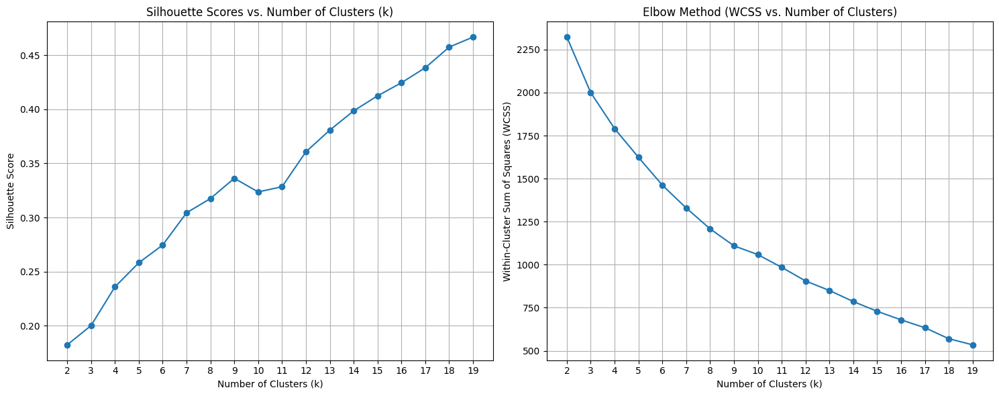

In [ ]:
# Determine the optimal number of clusters (k) using the silhouette method and Elbow method
silhouette_scores = []
wcss = [] # To store WCSS values
K_range = range(2, 20) # You can adjust the range of k values

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=seed, n_init=10)
    kmeans.fit(X_train_encoded)
    score = silhouette_score(X_train_encoded, kmeans.labels_)
    silhouette_scores.append(score)
    wcss.append(kmeans.inertia_) # inertia_ is the WCSS

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Plot the silhouette scores for different k values
axes[0].plot(K_range, silhouette_scores, marker='o')
axes[0].set_title('Silhouette Scores vs. Number of Clusters (k)')
axes[0].set_xlabel('Number of Clusters (k)')
axes[0].set_ylabel('Silhouette Score')
axes[0].set_xticks(K_range)
axes[0].grid(True)

# Plot the WCSS for different k values (Elbow Method)
axes[1].plot(K_range, wcss, marker='o')
axes[1].set_title('Elbow Method (WCSS vs. Number of Clusters)')
axes[1].set_xlabel('Number of Clusters (k)')
axes[1].set_ylabel('Within-Cluster Sum of Squares (WCSS)')
axes[1].set_xticks(K_range)
axes[1].grid(True)

plt.tight_layout() # Adjust layout to prevent overlap
plt.show()


--- Visualizing Silhouette for optimal k = 12 ---
0.36067915


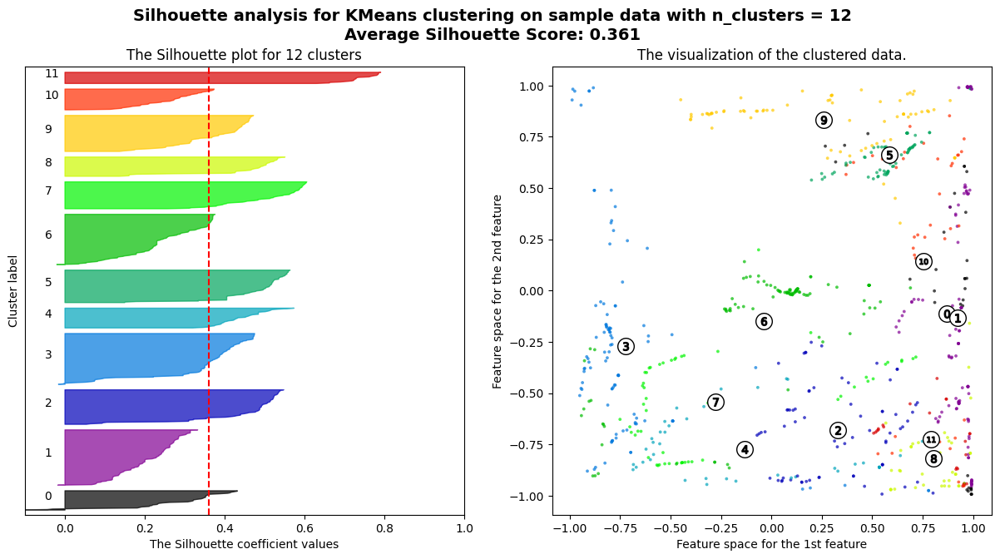

In [ ]:
optimal_k =12 # Replace with the k you found to be optimal from the plot

# --- Part 2: Visualizing Individual Silhouette Scores (Silhouette Plot) ---

print(f"\n--- Visualizing Silhouette for optimal k = {optimal_k} ---")

# Re-run K-means with the optimal k
kmeans_optimal = KMeans(n_clusters=optimal_k, random_state=seed, n_init=10)
cluster_labels_optimal = kmeans_optimal.fit_predict(X_train_encoded)
silhouette_avg_optimal = silhouette_score(X_train_encoded, cluster_labels_optimal)
sample_silhouette_values = silhouette_samples(X_train_encoded, cluster_labels_optimal)
print(silhouette_avg_optimal)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7))

# The 1st subplot is the silhouette plot
ax1.set_xlim([-0.1, 1]) # Silhouette scores range from -1 to +1, so we set a reasonable x-limit
ax1.set_ylim([0, len(X_train_encoded) + (optimal_k + 1) * 10]) # Space between clusters

y_lower = 10
for i in range(optimal_k):
    # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels_optimal == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.nipy_spectral(float(i) / optimal_k)
    ax1.fill_betweenx(np.arange(y_lower, y_upper),
                      0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)

    # Label the silhouette plots with their cluster numbers at the middle
    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    # Compute the new y_lower for next plot
    y_lower = y_upper + 10 # 10 for the 0 samples

ax1.set_title(f"The Silhouette plot for {optimal_k} clusters")
ax1.set_xlabel("The Silhouette coefficient values")
ax1.set_ylabel("Cluster label")

  # The vertical line for average silhouette score of all the values
ax1.axvline(x=silhouette_avg_optimal, color="red", linestyle="--")
ax1.set_yticks([]) # Clear the yaxis labels / ticks

  # 2nd Plot showing the actual clusters formed
colors = cm.nipy_spectral(cluster_labels_optimal.astype(float) / optimal_k)
ax2.scatter(X_train_encoded[:, 0], X_train_encoded[:, 1], marker='.', s=30, lw=0, alpha=0.7,
              c=colors, edgecolor='k')

  # Labeling the clusters
centers = kmeans_optimal.cluster_centers_
ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
              c="white", alpha=1, s=200, edgecolor='k')

for i, c in enumerate(centers):
    ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                  s=50, edgecolor='k')

ax2.set_title("The visualization of the clustered data.")
ax2.set_xlabel("Feature space for the 1st feature")
ax2.set_ylabel("Feature space for the 2nd feature")

plt.suptitle((f"Silhouette analysis for KMeans clustering on sample data "
                f"with n_clusters = {optimal_k}\n"
                f"Average Silhouette Score: {silhouette_avg_optimal:.3f}"),
              fontsize=14, fontweight='bold')
plt.show()

Looking at the Silhouette Score plot, the score generally increases as 'k' increases, suggesting that a higher number of clusters might be better in terms of how well samples are separated within their clusters. There's a notable increase around k=12 to k=15.

Looking at the Elbow Method plot, we look for a point where the decrease in WCSS starts to level off, forming an "elbow". This often suggests that adding more clusters beyond this point doesn't significantly reduce the within-cluster variance. In this plot, there appears to be an elbow around k=5 or k=6, and perhaps another around k=10 to k=12.

Considering both plots, a value of k=12 seems like a reasonable choice. The Silhouette score shows a significant increase around this point, and while the Elbow method doesn't have a sharp elbow, there's a change in the rate of decrease of WCSS around this area. It represents a balance between maximizing the silhouette score and minimizing the WCSS without creating too many clusters.

In [ ]:
num_of_features = len(X_test_encoded[0])
X_train_encoded_df = pd.DataFrame(X_train_encoded,columns=[f'f{i+1}' for i in range(num_of_features)])
X_train_encoded_df.head(3)

,f1,f2,f3,f4,f5,f6,f7,f8,f9,f10
0,0.484392,0.026183,0.066416,-0.467981,0.043041,-0.735123,-0.751792,-0.880315,0.235681,-0.465987
1,-0.769056,-0.701215,0.016127,0.797218,-0.250916,0.285704,0.576072,-0.895616,-0.874505,0.497252
2,0.350029,-0.426527,-0.756511,0.337308,0.821511,0.410779,-0.424667,-0.953848,-0.267589,-0.044983


In [ ]:
X_test_encoded_df = pd.DataFrame(X_test_encoded,columns=[f'f{i+1}' for i in range(num_of_features)])
X_test_encoded_df.head(3)

,f1,f2,f3,f4,f5,f6,f7,f8,f9,f10
0,-0.052123,-0.551667,0.226737,-0.317025,0.153110,-0.007342,-0.287113,-0.244522,-0.157962,-0.354001
1,0.250881,-0.325526,-0.133326,0.125694,0.283405,0.392936,-0.252647,-0.340921,0.205039,0.021047
2,0.315538,-0.211320,0.054943,0.311696,0.111445,0.178408,-0.070286,-0.564540,-0.052207,-0.442640


In [ ]:
# Assign cluster labels to train_users DataFrame
X_train_encoded_df['cluster'] = cluster_labels_optimal

display(X_train_encoded_df.head())

,f1,f2,f3,f4,f5,f6,f7,f8,f9,f10,cluster
0,0.484392,0.026183,0.066416,-0.467981,0.043041,-0.735123,-0.751792,-0.880315,0.235681,-0.465987,6
1,-0.769056,-0.701215,0.016127,0.797218,-0.250916,0.285704,0.576072,-0.895616,-0.874505,0.497252,3
2,0.350029,-0.426527,-0.756511,0.337308,0.821511,0.410779,-0.424667,-0.953848,-0.267589,-0.044983,2
3,0.977258,0.473326,0.419200,0.795806,0.335621,-0.405393,0.331063,-0.921260,-0.872620,-0.406025,1
4,0.103146,-0.013479,0.266883,-0.260860,-0.374493,-0.082859,-0.588133,-0.730107,0.241450,-0.718510,6


In [ ]:
cluster_labels_optimal_test = kmeans_optimal.predict(X_test_encoded)
X_test_encoded_df['cluster'] = cluster_labels_optimal_test

X_test_encoded_df.head(3)

,f1,f2,f3,f4,f5,f6,f7,f8,f9,f10,cluster
0,-0.052123,-0.551667,0.226737,-0.317025,0.153110,-0.007342,-0.287113,-0.244522,-0.157962,-0.354001,6
1,0.250881,-0.325526,-0.133326,0.125694,0.283405,0.392936,-0.252647,-0.340921,0.205039,0.021047,2
2,0.315538,-0.211320,0.054943,0.311696,0.111445,0.178408,-0.070286,-0.564540,-0.052207,-0.442640,6


<h2> recommedation steps </h2>


In [ ]:
# Add UID column back to the encoded training DataFrame
X_train_encoded_df['UID'] = train_users['UID'].values

# Display the first few rows with the UID column
display(X_train_encoded_df.head())

,f1,f2,f3,f4,f5,f6,f7,f8,f9,f10,cluster,UID
0,0.484392,0.026183,0.066416,-0.467981,0.043041,-0.735123,-0.751792,-0.880315,0.235681,-0.465987,6,245
1,-0.769056,-0.701215,0.016127,0.797218,-0.250916,0.285704,0.576072,-0.895616,-0.874505,0.497252,3,83
2,0.350029,-0.426527,-0.756511,0.337308,0.821511,0.410779,-0.424667,-0.953848,-0.267589,-0.044983,2,317
3,0.977258,0.473326,0.419200,0.795806,0.335621,-0.405393,0.331063,-0.921260,-0.872620,-0.406025,1,351
4,0.103146,-0.013479,0.266883,-0.260860,-0.374493,-0.082859,-0.588133,-0.730107,0.241450,-0.718510,6,466


In [ ]:
test_users

,UID,age1,age2,age3,age4,age5,age6,gender1,gender2,job1,...,job12,job13,job14,job15,job16,job17,job18,job19,job20,job21
96,97,0.0,0.0,0.0,1.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
265,266,0.0,0.0,0.0,0.0,1.0,0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
810,811,0.0,0.0,1.0,0.0,0.0,0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23,24,0.0,1.0,0.0,0.0,0.0,0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30,31,0.0,1.0,0.0,0.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
832,833,0.0,0.0,1.0,0.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
551,552,0.0,0.0,0.0,1.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
109,110,1.0,0.0,0.0,0.0,0.0,0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
77,78,0.0,1.0,0.0,0.0,0.0,0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
X_test_encoded_df['UID'] = test_users['UID'].values
X_test_encoded_df.head(2)

,f1,f2,f3,f4,f5,f6,f7,f8,f9,f10,cluster,UID
0,-0.052123,-0.551667,0.226737,-0.317025,0.153110,-0.007342,-0.287113,-0.244522,-0.157962,-0.354001,6,97
1,0.250881,-0.325526,-0.133326,0.125694,0.283405,0.392936,-0.252647,-0.340921,0.205039,0.021047,2,266


In [ ]:


import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity

# -------------------------------------------------------------------
# 1. Precompute cluster‐popularity scores
# -------------------------------------------------------------------
clusters = np.unique(X_train_encoded_df['cluster'])
pop_score = {}  # dict: cluster_id → { MID: avg_rating }

for c in clusters:
    cluster_uids = X_train_encoded_df[X_train_encoded_df['cluster'] == c]['UID'].values
    # Consider only ratings >= 4 for popularity score
    sub = train_ratings[(train_ratings['UID'].isin(cluster_uids)) & (train_ratings['rating'] >= 4)]
    if not sub.empty: # Avoid empty groupby
        grp = sub.groupby('MID')['rating'].mean()
        pop_score[c] = grp.to_dict()
    else:
        pop_score[c] = {}


# -------------------------------------------------------------------
# 2. Build UID→row‐index map for fast lookup
# -------------------------------------------------------------------
# This is not used in the recommend_for function as it was implemented.
# It's left here in case it's needed for future modifications.
uid_to_idx = {uid: i for i, uid in enumerate(X_train_encoded_df['UID'].values)}


# -------------------------------------------------------------------
# 3. Recommendation function using α‐blend of pop + personalized
# -------------------------------------------------------------------
alpha = 0.85
K = 10
all_items = all_ratings['MID'].unique()



In [ ]:

def recommend_for(test_uid):
    # Get cluster of test user
    test_user_cluster_df = X_test_encoded_df[X_test_encoded_df['UID'] == test_uid]
    if test_user_cluster_df.empty:
        return [], {} # Return empty lists if test user not found

    c = test_user_cluster_df['cluster'].values[0]

    # Get test user embedding
    u_vec = test_user_cluster_df.drop(columns=['UID', 'cluster']).values

    # Get train embeddings in same cluster
    train_cluster_df = X_train_encoded_df[X_train_encoded_df['cluster'] == c]
    if train_cluster_df.empty:
         return [], {} # Return empty lists if no train users in cluster

    train_embs = train_cluster_df.drop(columns=['UID', 'cluster']).values
    sim = cosine_similarity(u_vec, train_embs).flatten()

    # Get train UIDs in cluster
    cluster_uids = train_cluster_df['UID'].values
    # Consider only ratings >= 4 for personalized score calculation
    sub = train_ratings[(train_ratings['UID'].isin(cluster_uids)) & (train_ratings['rating'] >= 4)]


    # Personalized score
    uid_to_local_idx = {uid: i for i, uid in enumerate(cluster_uids)}
    pers = {}
    for _, row in sub.iterrows():
        v_uid = row['UID']
        i_mid = row['MID']
        r = row['rating']
        if v_uid in uid_to_local_idx: # Check if UID is in the current cluster's mapping
             v_idx = uid_to_local_idx[v_uid]
             pers[i_mid] = pers.get(i_mid, 0.0) + sim[v_idx] * r


    # Final score
    scores = {}
    pop_c = pop_score.get(c, {})
    for i in all_items:
        # Only consider items that are in either the popularity or personalized scores (meaning they had a relevant rating)
        if i in pop_c or i in pers:
             p_sc = pop_c.get(i, 0.0)
             u_sc = pers.get(i, 0.0)
             scores[i] = alpha * p_sc + (1 - alpha) * u_sc


    # Filter out items that were not considered due to low ratings in the training data
    ranked = sorted([item for item in scores if scores[item] > 0], key=scores.get, reverse=True)

    return ranked[:K], scores

In [ ]:

# List of test UIDs
test_uids = X_test_encoded_df['UID'].values

# Initialize storage
recos = []         # list of top-K recommended MIDs per test user
score_dicts = []   # list of full score dictionaries per test user

# Loop over test users
for test_uid in test_uids:
    top_k_items, score_dict = recommend_for(test_uid)
    recos.append(top_k_items)
    score_dicts.append(score_dict)


In [ ]:


def precision_at_k(recos, test_ratings, K=10):

    # Build ground truth: UID → set of relevant MIDs
    relevant_items = test_ratings[test_ratings['rating'] >= 4].groupby('UID')['MID'].apply(set).to_dict()

    precisions = []
    test_uids = X_test_encoded_df['UID'].values

    for uid, reco_list in zip(test_uids, recos):
        true_items = relevant_items.get(uid, set())
        if not true_items:
            continue  # skip users with no test ratings

        hits = sum(1 for mid in reco_list if mid in true_items)
        precisions.append(hits / K)

    return np.mean(precisions)

p_at_10 = precision_at_k(recos, test_ratings, K=10)
print(f"Precision@10: {p_at_10:.4f}")


Precision@10: 0.3524


In [ ]:
def recall_at_k(recos, test_ratings, K=10):
    """
    recos: list of lists, each containing top-K recommended MIDs for a test UID
    test_ratings: DataFrame with columns ['UID', 'MID', 'rating']
    K: number of top items to consider
    """
    # Ground truth: UID → set of relevant MIDs (ratings ≥ 4)
    relevant_items = test_ratings[test_ratings['rating'] >= 4].groupby('UID')['MID'].apply(set).to_dict()

    recalls = []
    test_uids = X_test_encoded_df['UID'].values

    for uid, reco_list in zip(test_uids, recos):
        true_items = relevant_items.get(uid, set())
        if not true_items:
            continue  # skip users with no relevant items

        hits = sum(1 for mid in reco_list if mid in true_items)
        recalls.append(hits / len(true_items) if len(true_items)>0 else 0)

    return np.mean(recalls)


In [ ]:
recall_at_k(recos, test_ratings, K=10)

np.float64(0.07375871313188773)

In [ ]:
alphas = np.arange(0.0, 1.05, 0.1)
results = []
recall_results = []

for alpha_val in alphas:
    alpha = alpha_val  # update global alpha used in recommend_for()

    recos = []
    score_dicts = []
    for test_uid in test_uids:
        top_k_items, score_dict = recommend_for(test_uid)
        recos.append(top_k_items)
        score_dicts.append(score_dict)

    p_at_10 = precision_at_k(recos, test_ratings, K=10)
    r_at_10 = recall_at_k(recos, test_ratings, K=10)


    results.append((alpha_val, p_at_10))
    recall_results.append((alpha_val, r_at_10))

# Plotting
import matplotlib.pyplot as plt

alphas_list, precisions = zip(*results)
alphas_list_recall, recalls = zip(*recall_results)

plt.figure(figsize=(10, 6))
plt.plot(alphas_list, precisions, label='Precision@10')
plt.plot(alphas_list_recall, recalls, label='Recall@10')

plt.xlabel('Alpha (Blend Ratio)')
plt.ylabel('Score')
plt.title('Effect of Alpha on Recommendation Metrics')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
def random_precision_at_k(test_ratings, all_items, K=10):
    test_uids = test_ratings['UID'].unique()
    relevant_items = test_ratings[test_ratings['rating'] >= 4].groupby('UID')['MID'].apply(set).to_dict()
    precisions = []
    for uid in test_uids:
        true_items = relevant_items.get(uid, set())
        if not true_items:
            continue
        random_reco = np.random.choice(all_items, K, replace=False)
        hits = sum(1 for mid in random_reco if mid in true_items)
        precisions.append(hits / K)
    return np.mean(precisions)

baseline = random_precision_at_k(test_ratings, all_items)
print(f"Random baseline Precision@10: {baseline:.4f}")

In [ ]:
# Calculate the average number of movies each user rated
average_ratings_per_user = all_ratings.groupby('UID')['MID'].count().mean()
print(f"Average number of movies rated per user: {average_ratings_per_user:.2f}")

<h2> GHRS_Precision </h2>

In [ ]:
# Map UID to cluster
uid_cluster_map = X_train_encoded_df.set_index('UID')['cluster'].to_dict()

# Add cluster info to train_ratings
train_ratings['cluster'] = train_ratings['UID'].map(uid_cluster_map)

# Compute cluster–item average ratings
cluster_item_avg = train_ratings.groupby(['cluster', 'MID'])['rating'].mean().to_dict()


In [ ]:
def predict_cluster_avg(uid, mid, cluster_item_avg, X_test_encoded_df):
    cluster = X_test_encoded_df.loc[X_test_encoded_df['UID'] == uid, 'cluster'].values
    if len(cluster) == 0:
        return np.nan
    cluster_id = cluster[0]
    return cluster_item_avg.get((cluster_id, mid), np.nan)


In [ ]:
test_ratings['pred_cluster_avg'] = test_ratings.apply(
    lambda row: predict_cluster_avg(row['UID'], row['MID'], cluster_item_avg, X_test_encoded_df),
    axis=1
)


In [ ]:
from sklearn.metrics import mean_squared_error

valid_preds = test_ratings.dropna(subset=['pred_cluster_avg'])
rmse = mean_squared_error(valid_preds['rating'], valid_preds['pred_cluster_avg'], squared=False)
print(f"RMSE (Cluster Avg for Cold-Start Users): {rmse:.4f}")
